In [1]:
import scanpy as sc
import anndata as ad
# import squidpy as sq

from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
from tqdm import tqdm
import umap
from sklearn.cluster import DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage, distance, fcluster
from sklearn.preprocessing import StandardScaler
import matplotlib as mpl
from plot_spatial import *
from sklearn.decomposition import PCA

/data/olga/anaconda3/envs/torch_gnn/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/data/olga/anaconda3/envs/torch_gnn/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/data/olga/anaconda3/envs/torch_gnn/lib/python3.10/site-packages/uma

In [2]:
umap.UMAP().fit_transform(np.random.randn(10_000, 20))


array([[6.637912 , 4.229381 ],
       [6.144226 , 6.8730617],
       [6.2472606, 3.7542994],
       ...,
       [6.891344 , 4.414555 ],
       [7.260766 , 3.9321225],
       [6.6959167, 4.8953214]], dtype=float32)

In [2]:
adata = sc.read_h5ad("../data/interim/visium_annotated_gat.h5ad")

In [3]:
clone_col = [ '0', '1', '2', '3', '4', '5',
       '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', 'diploid']
ct_col = ['B.cells', 'T.cells', 'Endothelial', 'CAFs', 'Plasmablasts', 'Myeloid','Cancer Epithelial', 'Normal Epithelial', 'PVL']
clone_mat = adata.obs[clone_col]

In [4]:
# convert array_row and array_col columns to integers in visium.obs dataframe
adata.obs["array_row"] = adata.obs["array_row"].astype(int)
adata.obs["array_col"] = adata.obs["array_col"].astype(int)

In [18]:
import matplotlib.colors
clones_columns = clone_col
ct_columns = ct_col
palette_clone = sns.color_palette("tab20", len(clones_columns))
palette_ct = sns.color_palette("Paired", len(ct_columns))
palette_clone = dict(zip(sorted(clones_columns), palette_clone))
palette_ct = dict(zip(sorted(ct_columns), palette_ct))



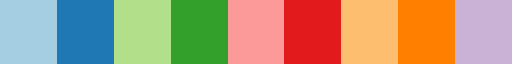

In [12]:
cmap_ct

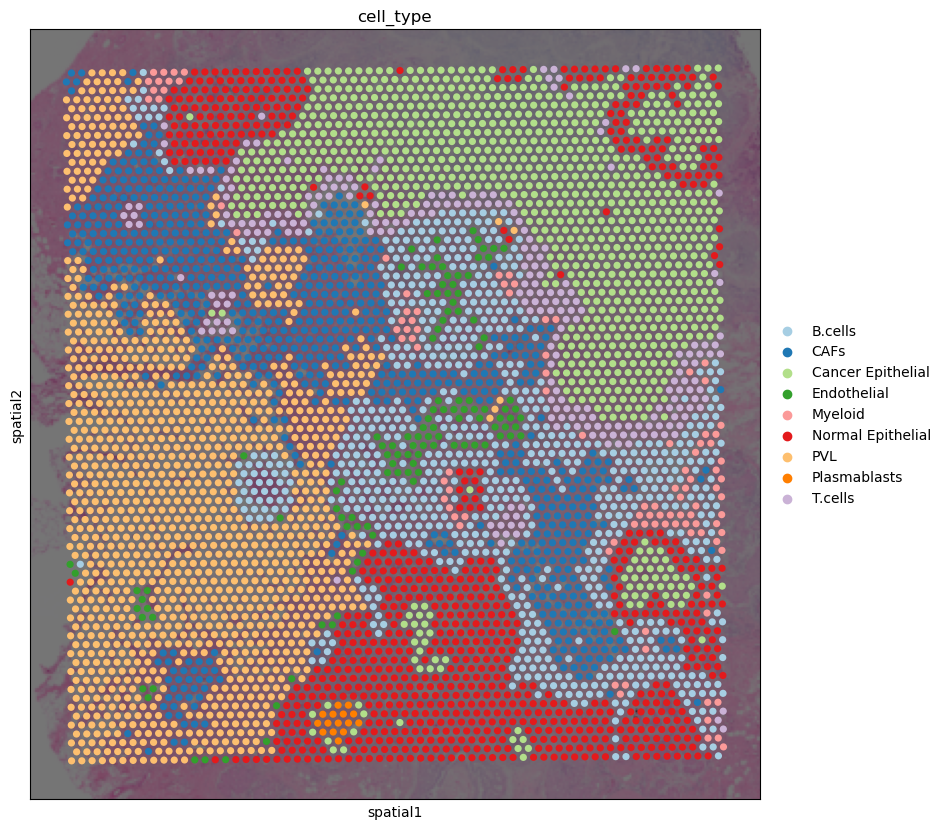

In [13]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata, cmap='magma',
                  # show first 8 cell types
                  color="cell_type",palette = dict(zip(sorted(ct_columns), palette_ct)),
                img_key='lowres', alpha_img = 0.5,
                 )

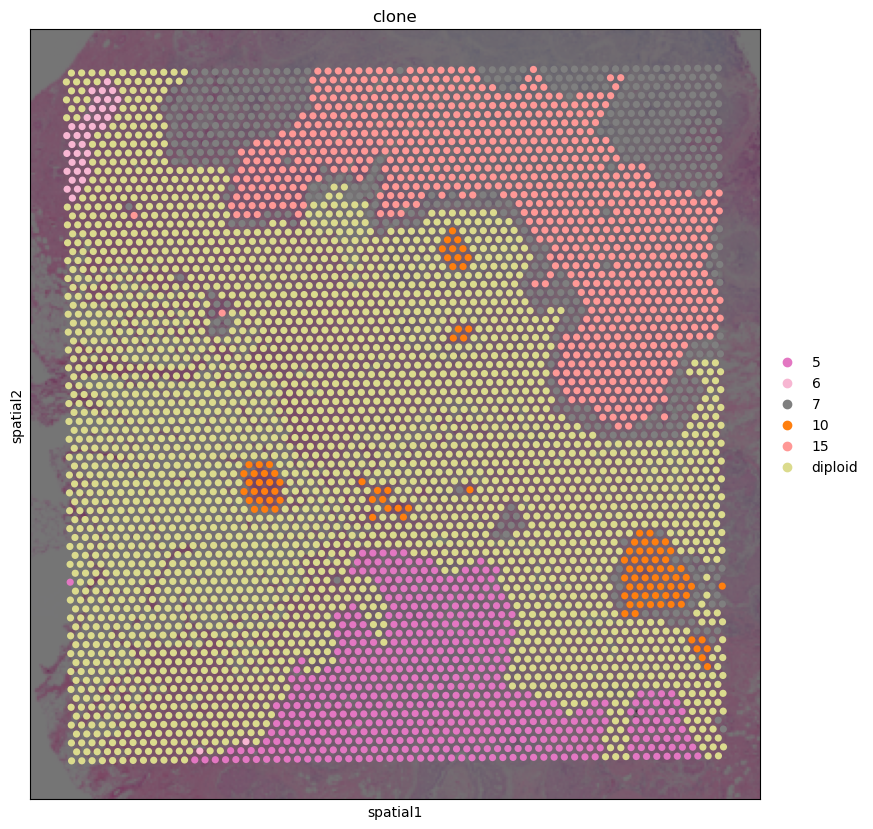

In [19]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata, cmap='magma',
                  # show first 8 cell types
                  color="clone",palette = palette_clone,
                img_key='lowres', alpha_img = 0.5,
                 )

In [ ]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata, cmap='magma',
                  # show first 8 cell types
                  color="cell_type",palette = cmap_ct
                img_key='lowres', alpha_img = 0.5,
                 )

In [20]:
clone_col_high = ['2','4','5','6','7','8','10','11','12','14','15','diploid']

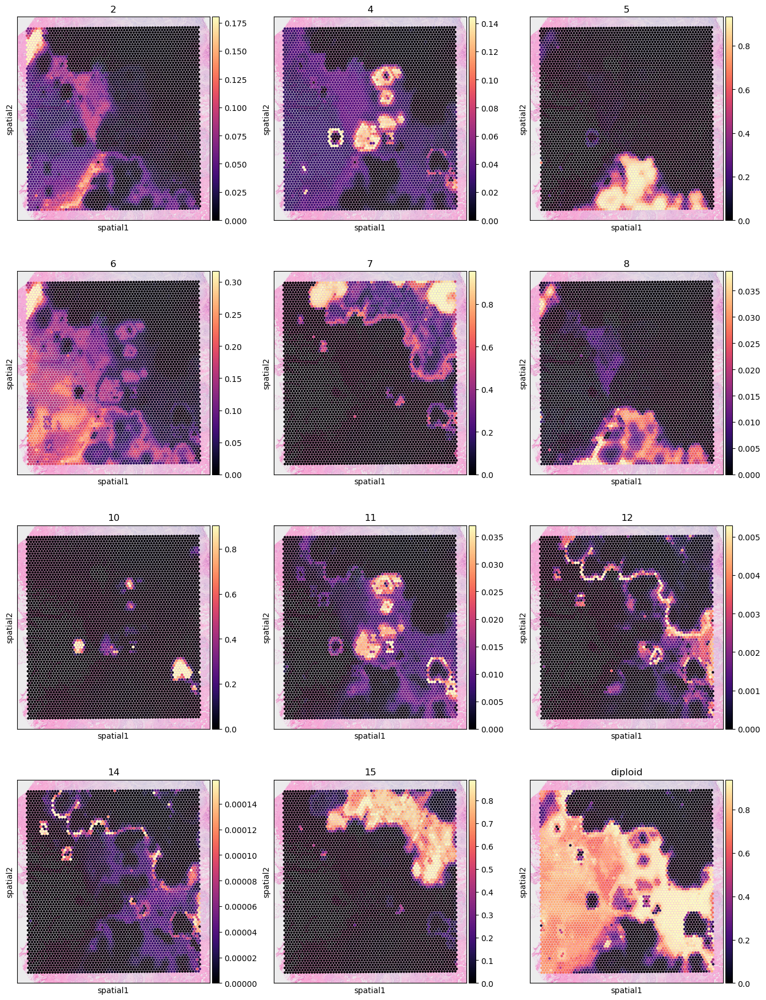

In [21]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(adata, cmap='magma',
                  # show first 8 cell types
                  color=clone_col_high,
                  ncols=3, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2', show = True, save = "clone_maps.png"
                 )
    
    

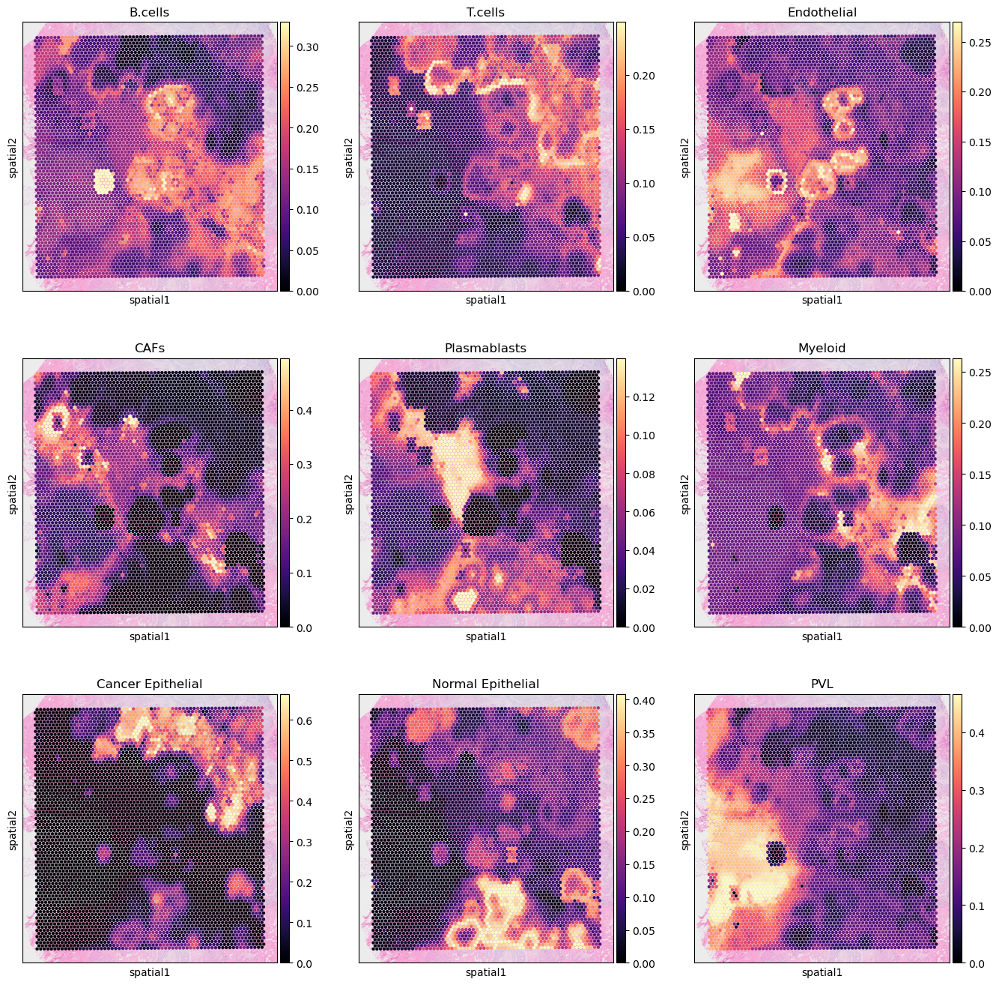

In [8]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    fig = sc.pl.spatial(adata, cmap='magma',
                  # show first 8 cell types
                  color=ct_col,
                  ncols=3, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2', show = True, save = "ct_maps.png")
    # fig.savefig("../reports/figures/ct_maps.png", dpi = 300)

# Compute niches

In [9]:
def spatial_negborhood(adata, d, clone_mat, method = "PCA", n_comp = 2):
    if d>0:
        vis_nodes = adata.obs.index
        edges_vis = dict()
        for node in vis_nodes:
            edges_vis[node] = []
            x= adata.obs.loc[node].array_row
            y= adata.obs.loc[node].array_col
            nodes = adata.obs[(adata.obs.array_row >=x-d)&(adata.obs.array_row <=x+d)&(adata.obs.array_col <=y+d)&(adata.obs.array_col >=y-d)].index
            for n in nodes:
                if n != node:
                    edges_vis[node].append(n)
        feature_set = []
        nodes = []
        for node in tqdm(edges_vis):
            neigb = edges_vis[node] + [node]
            feature_set.append(clone_mat.loc[neigb].mean().values)
            nodes.append(node)
        feature_set = pd.DataFrame(feature_set, index = nodes, columns = clone_mat.columns)
    else:
        feature_set = clone_mat
    scaled_features = StandardScaler().fit_transform(feature_set)
    # clustering = DBSCAN(eps=3, min_samples=2).fit(scaled_features)
    # reducer = umap.UMAP()
    if method == "PCA":
        reducer = PCA(n_components=n_comp)
    else:
        reducer = umap.UMAP(n_components=n_comp)
    
    embedding = reducer.fit_transform(scaled_features)
    dim_names = [f"{method}_{i}" for i in range(embedding.shape[1])]
    niches = pd.DataFrame(embedding.T, index = dim_names, columns = feature_set.index).T
    visium_tmp = adata.copy()
    visium_tmp.obs = visium_tmp.obs.join(niches)
    clust_labels = dim_names
    clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels
    # plot in spatial coordinates
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=visium_tmp,
            # labels to show on a plot
            color=clust_col, labels=clust_labels,
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right'
        )
    plt.show()
    return(niches, fig)

    

## Clonal

/data/olga/clonal_GNN/notebooks/plot_spatial.py:343: RuntimeWarning: invalid value encountered in divide
  weighted_colors_ryb = (colors_ryb * kernel_weights).sum(axis=1) / kernel_weights.sum(axis=1)


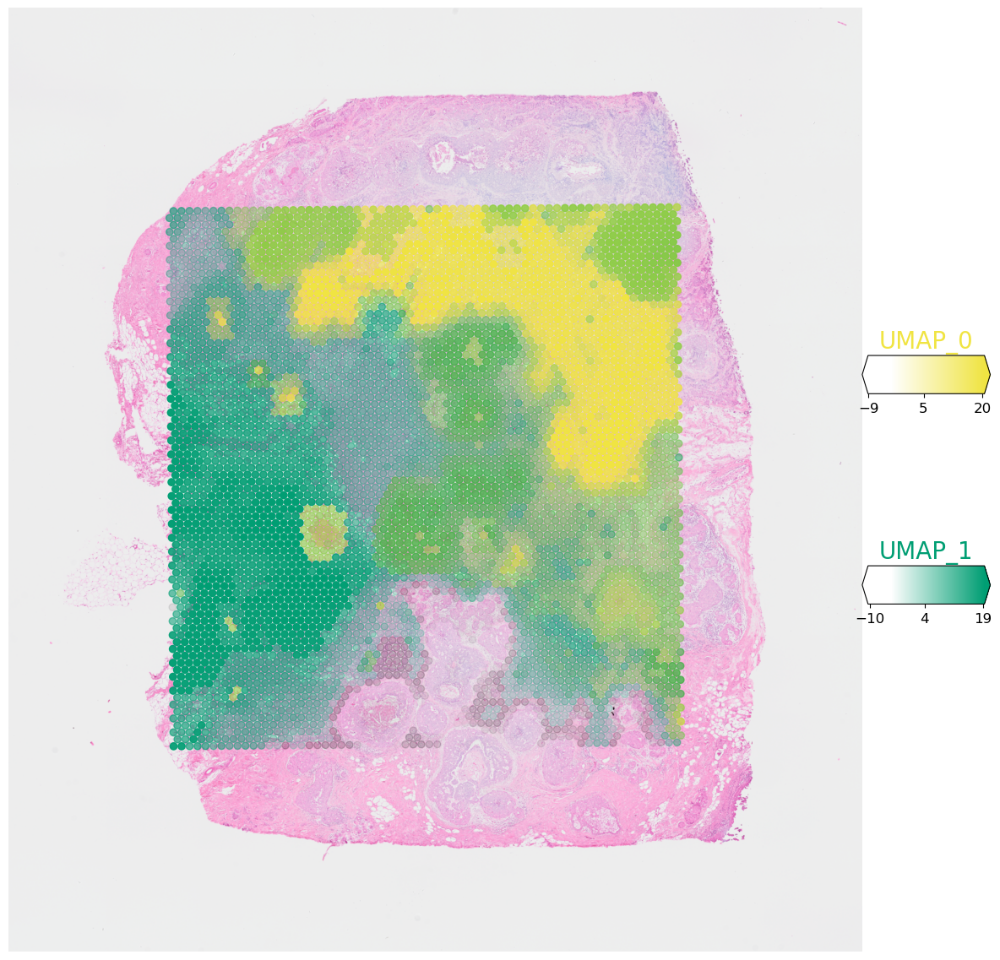

In [12]:
clone_mat = adata.obs[clone_col]

emb, fig = spatial_negborhood(adata, 0, clone_mat, "UMAP",2)
# fig.savefig("../reports/figures/umap_clones.png", dpi = 300)


 37%|███▋      | 1848/4992 [00:00<00:01, 3019.00it/s]

100%|██████████| 4992/4992 [00:01<00:00, 3074.28it/s]


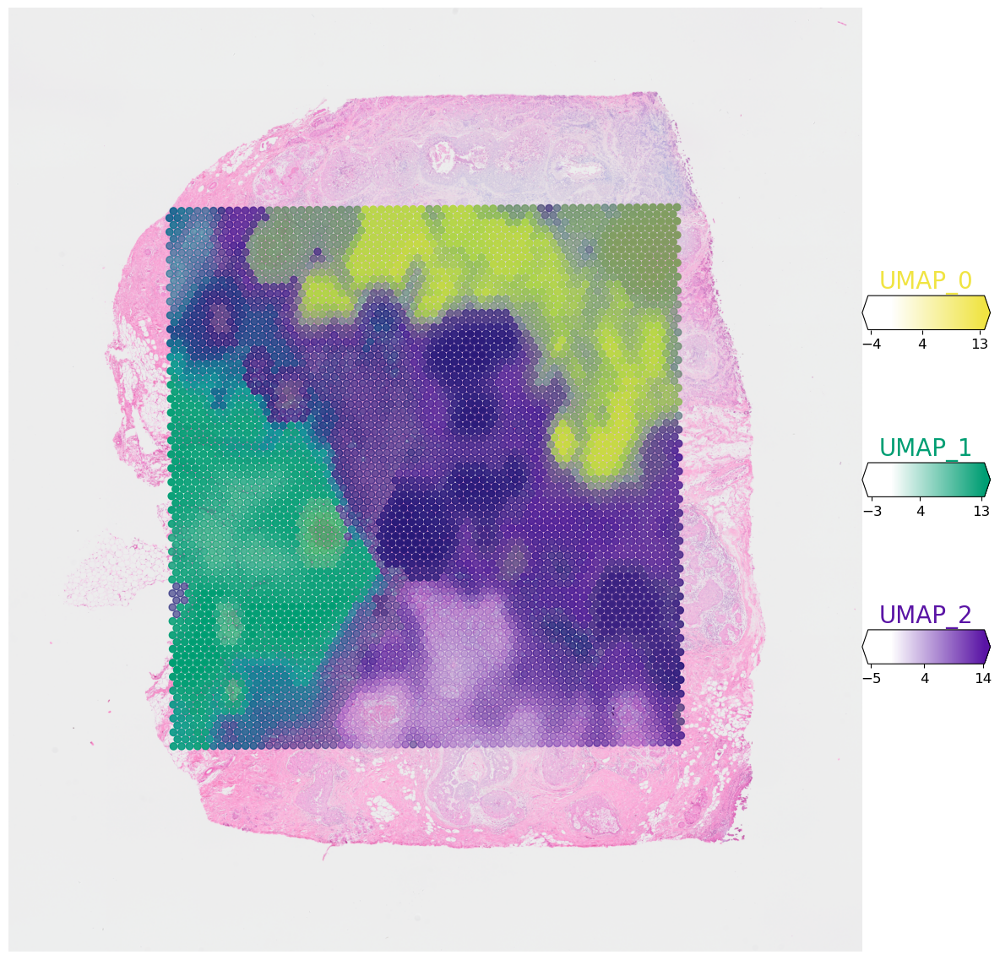

In [13]:
clone_mat = adata.obs[ct_col]

emb1, fig = spatial_negborhood(adata, 1, clone_mat, "UMAP",3 )
# fig.savefig("../reports/figures/umap_cts.png", dpi = 300)


100%|██████████| 4992/4992 [00:03<00:00, 1286.44it/s]


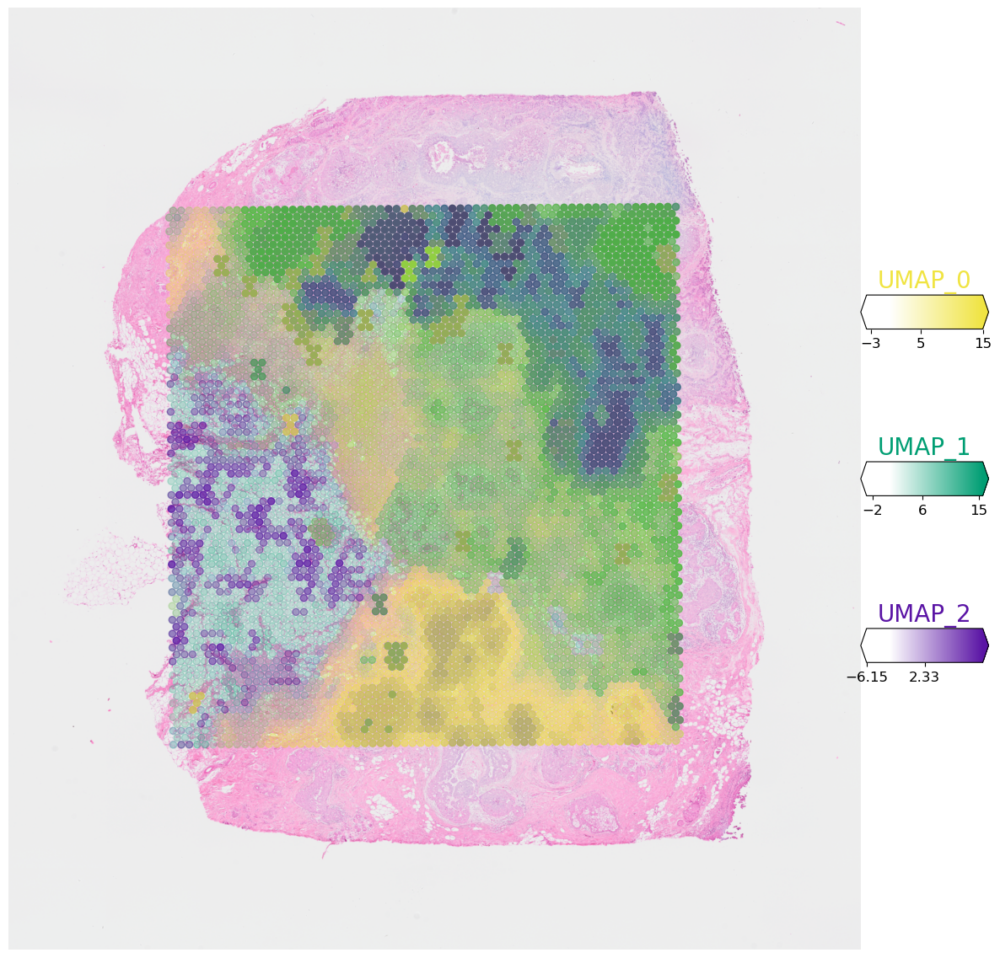

In [149]:
clone_mat = adata.obs[ct_col + clone_col]

emb1, fig = spatial_negborhood(adata, 1, clone_mat, "UMAP",3 )
fig.savefig("../reports/figures/umap_combined.png", dpi = 300)


In [14]:
norm_sim = np.load("../data/interim/clone_dist_over.npy")

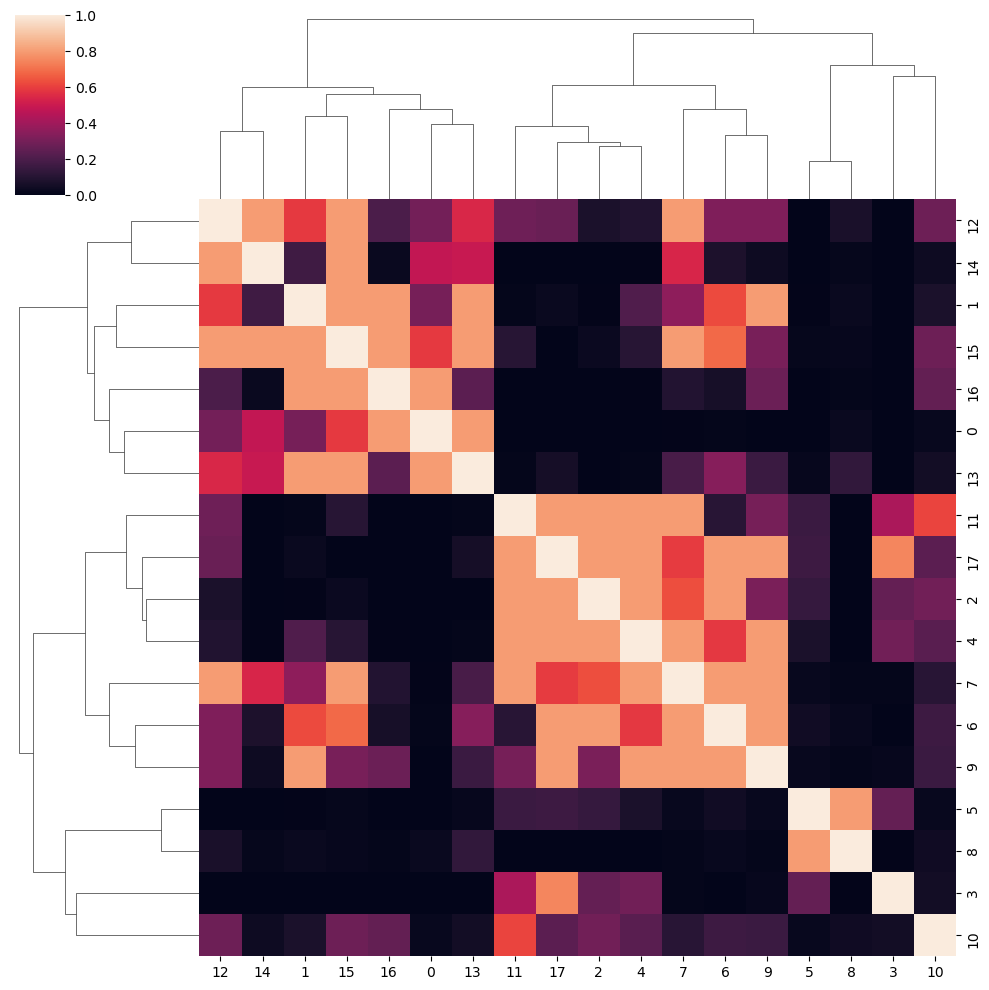

In [15]:
sns.clustermap(norm_sim)
plt.show()

In [16]:
norm_sim = pd.DataFrame(norm_sim, index = clone_col, columns = clone_col)

In [17]:
pdist = distance.pdist(norm_sim)
link = linkage(pdist, method='complete')


In [18]:
colors = sns.color_palette("tab10")


In [19]:
colors

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

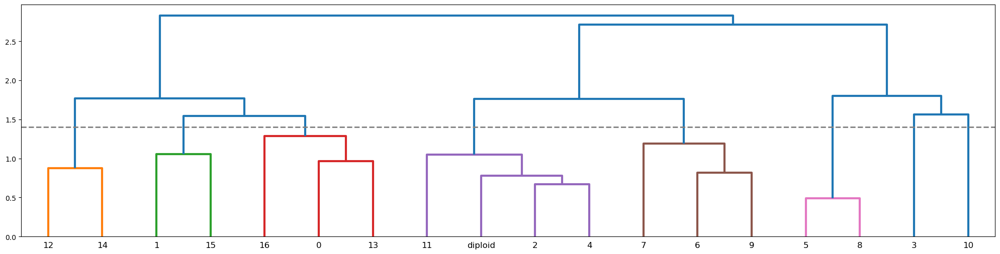

In [26]:
t = 1.4
fig = plt.figure(figsize=(25, 6))
with plt.rc_context({'lines.linewidth': 3}):

    dn = dendrogram(link,color_threshold = t, labels = norm_sim.columns)
plt.axhline(t, ls = "--", color = "grey", lw = 2 )
# plt.savefig("../reports/figures/dendrogram.pdf", dpi = 300)

plt.show()

In [21]:
clusters = fcluster(link, t, criterion='distance')

In [31]:
clone_mat = adata.obs[clone_col]


In [32]:
new_clones = []
new_cols = []
un_clusters = np.unique(clusters)
for cl in un_clusters:
    idx = np.where(clusters == cl)[0]
    old_clones =  norm_sim.columns[idx]
    act = clone_mat[old_clones].sum(axis = 1)
    new_clones.append(act.values)
    new_cols.append(" & ".join([str(x) for x in old_clones]))




    

In [33]:
new_clones = pd.DataFrame(new_clones, index = new_cols, columns = clone_mat.index).T

In [34]:
visium = adata.copy()

In [35]:
visium.obs = visium.obs.drop(columns = clone_col + ["clone"])

In [36]:
visium.obs = visium.obs.join(new_clones)

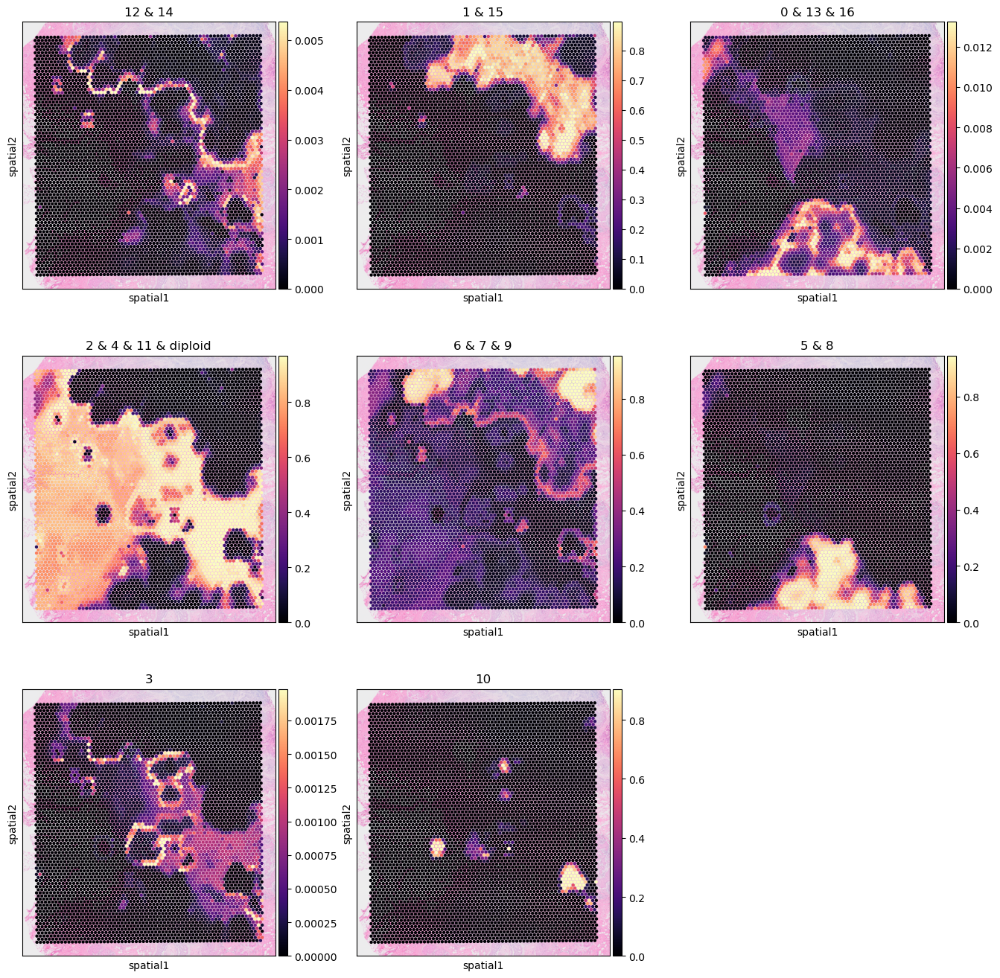

In [37]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(visium, cmap='magma',
                  # show first 8 cell types
                  color=new_cols,
                  ncols=3, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2',
                 )

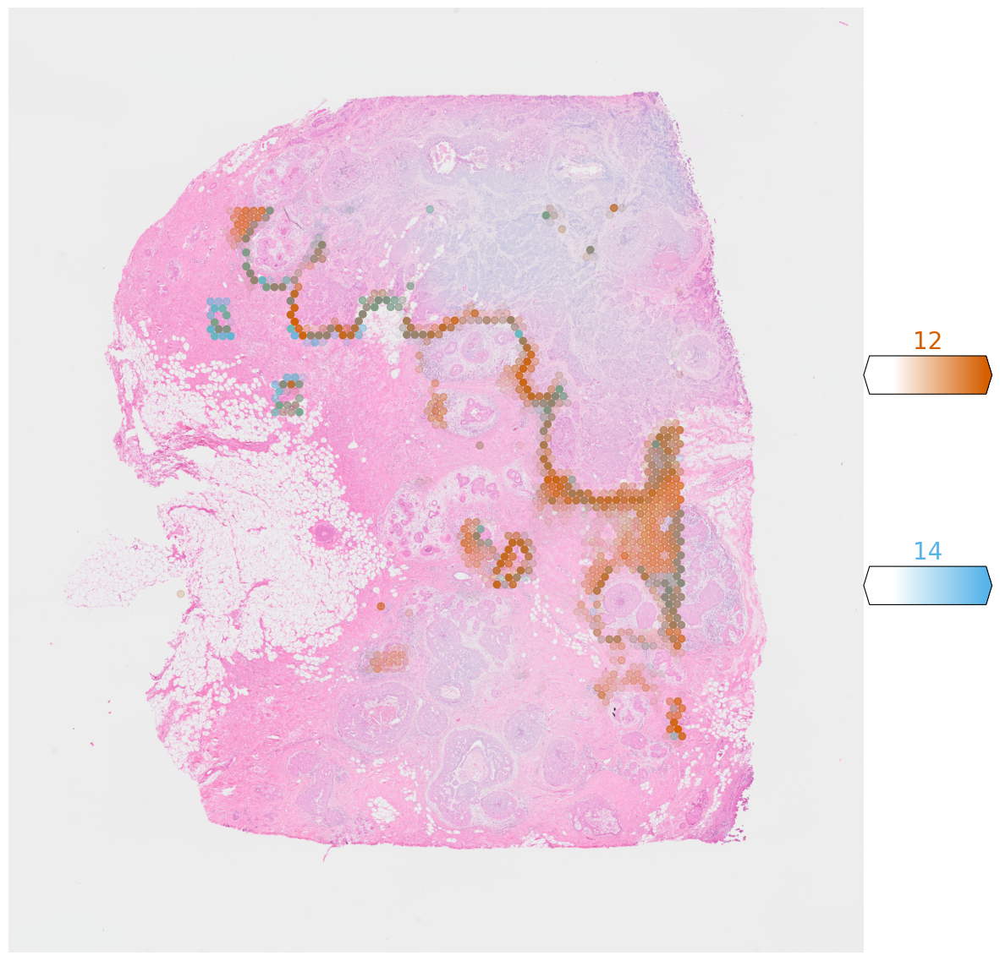

In [38]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['12','14'], labels=['12','14'],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right', reorder_cmap = [3,4,5,0,1,2,6]
        )
    # fig.savefig("../reports/figures/clones_12_14.png", dpi = 300)
    plt.show()

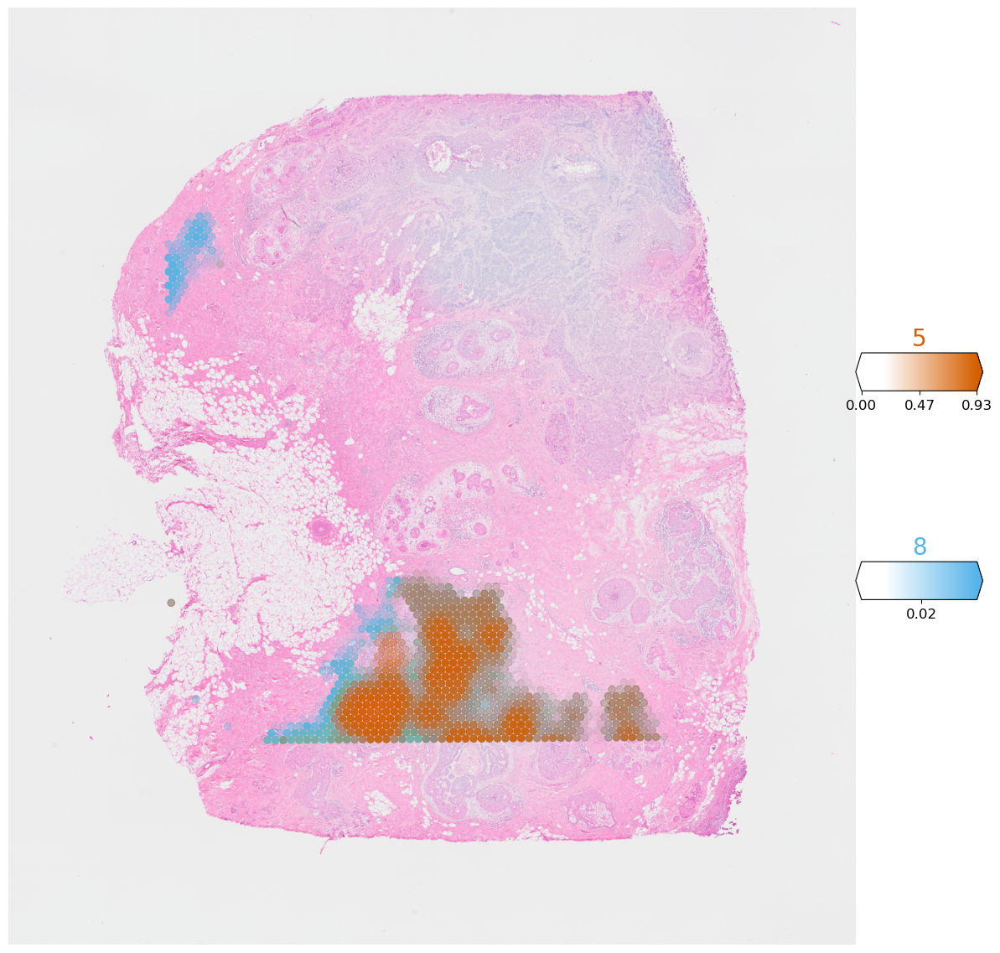

In [39]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['5','8'], labels=['5','8'],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right', reorder_cmap = [3,4,5,0,1,2,6]
        )
    # fig.savefig("../reports/figures/clones_5_8.png", dpi = 300)

    plt.show()

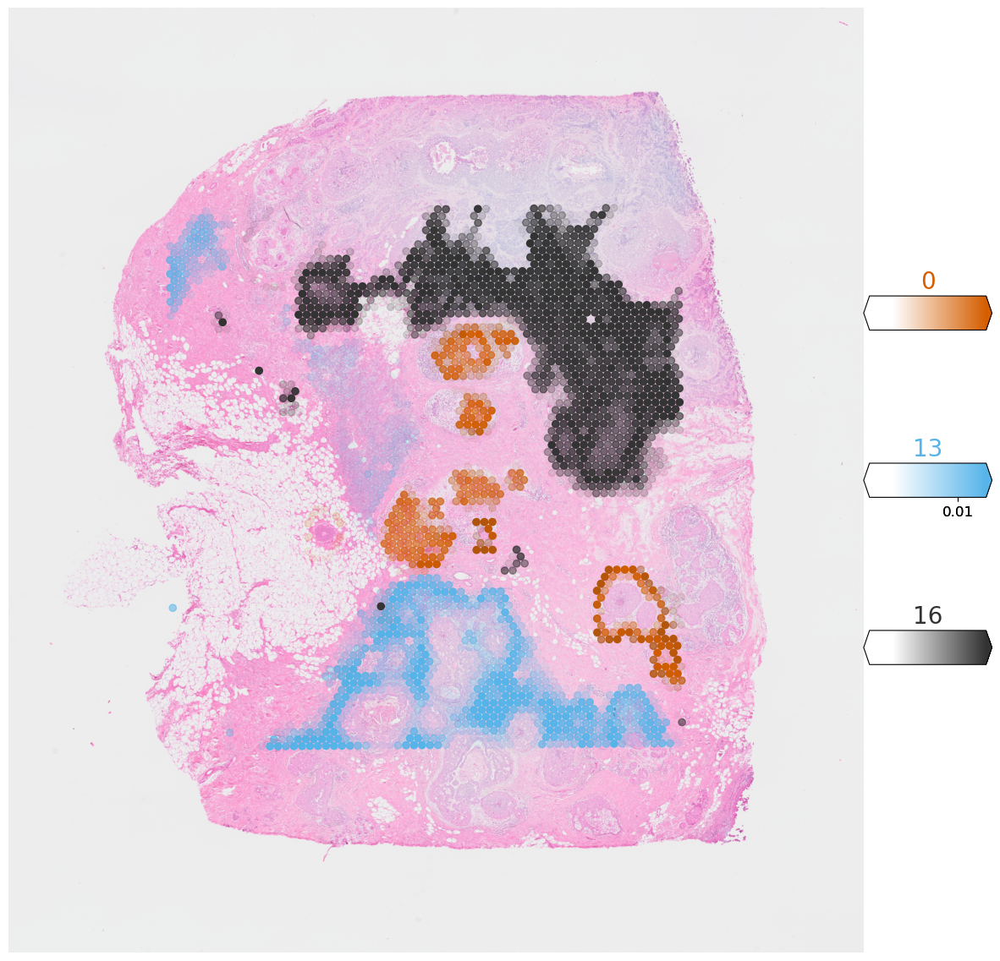

In [40]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['0','13', '16'], labels=['0','13','16'],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right', reorder_cmap = [3,4,6,0,1,2,5]
        )
    # fig.savefig("../reports/figures/clones_0_13_16.png", dpi = 300)

    plt.show()

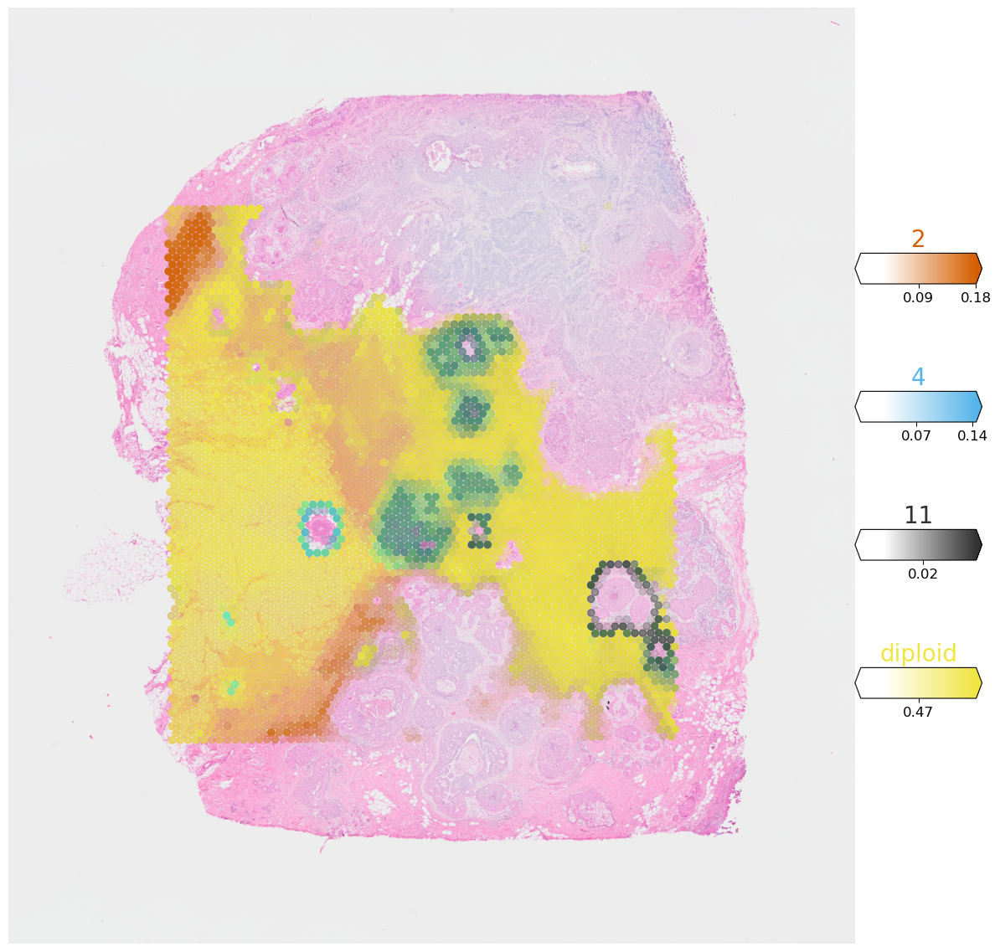

In [41]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['2','4', '11', "diploid"], labels=['2','4', '11', "diploid"],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right',reorder_cmap = [3,4,6,0,1,2,5]
        )
    # fig.savefig("../reports/figures/clones_diploid.png", dpi = 300)

    plt.show()

/omics/groups/OE0540/internal/users/olga/clonal_GNN/notebooks/plot_spatial.py:343: RuntimeWarning: invalid value encountered in divide
  weighted_colors_ryb = (colors_ryb * kernel_weights).sum(axis=1) / kernel_weights.sum(axis=1)


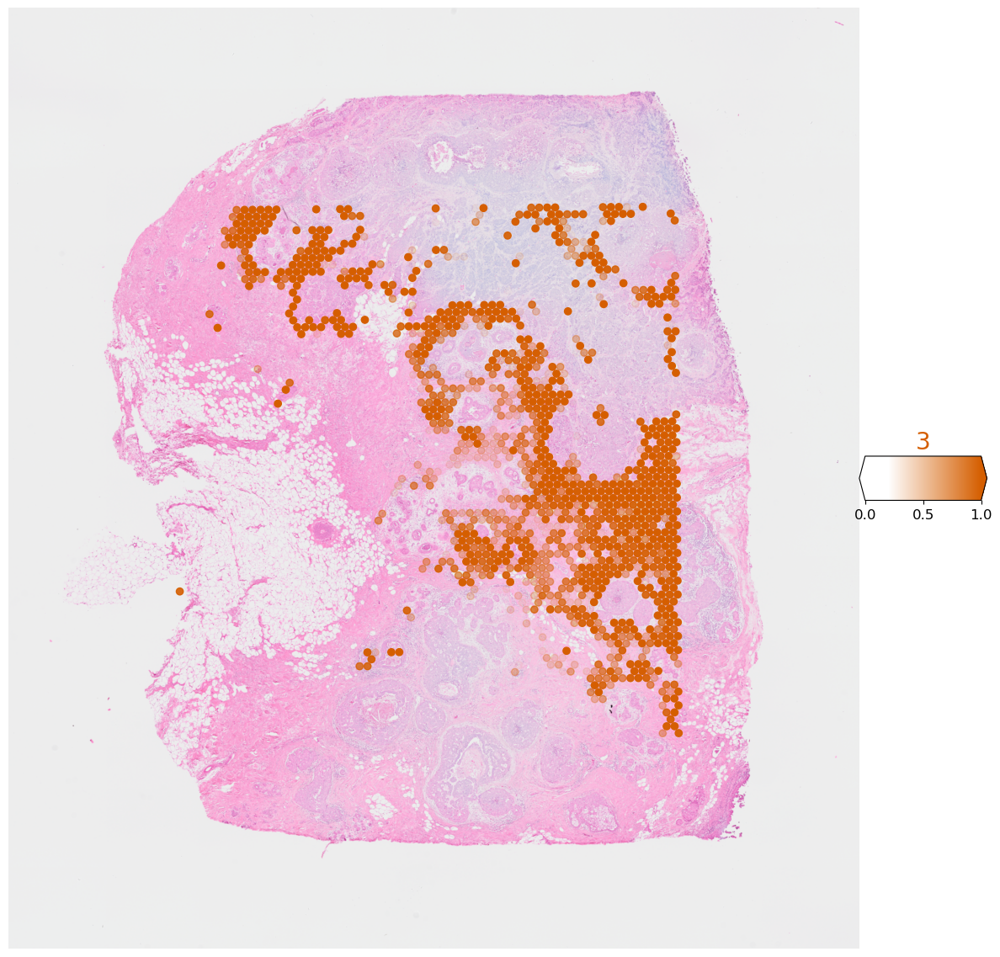

In [172]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['3'], labels=['3'],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right',reorder_cmap = [3,4,6,0,1,2,5]
        )
    fig.savefig("../reports/figures/clones_3.png", dpi = 300)

    plt.show()

/omics/groups/OE0540/internal/users/olga/clonal_GNN/notebooks/plot_spatial.py:343: RuntimeWarning: invalid value encountered in divide
  weighted_colors_ryb = (colors_ryb * kernel_weights).sum(axis=1) / kernel_weights.sum(axis=1)


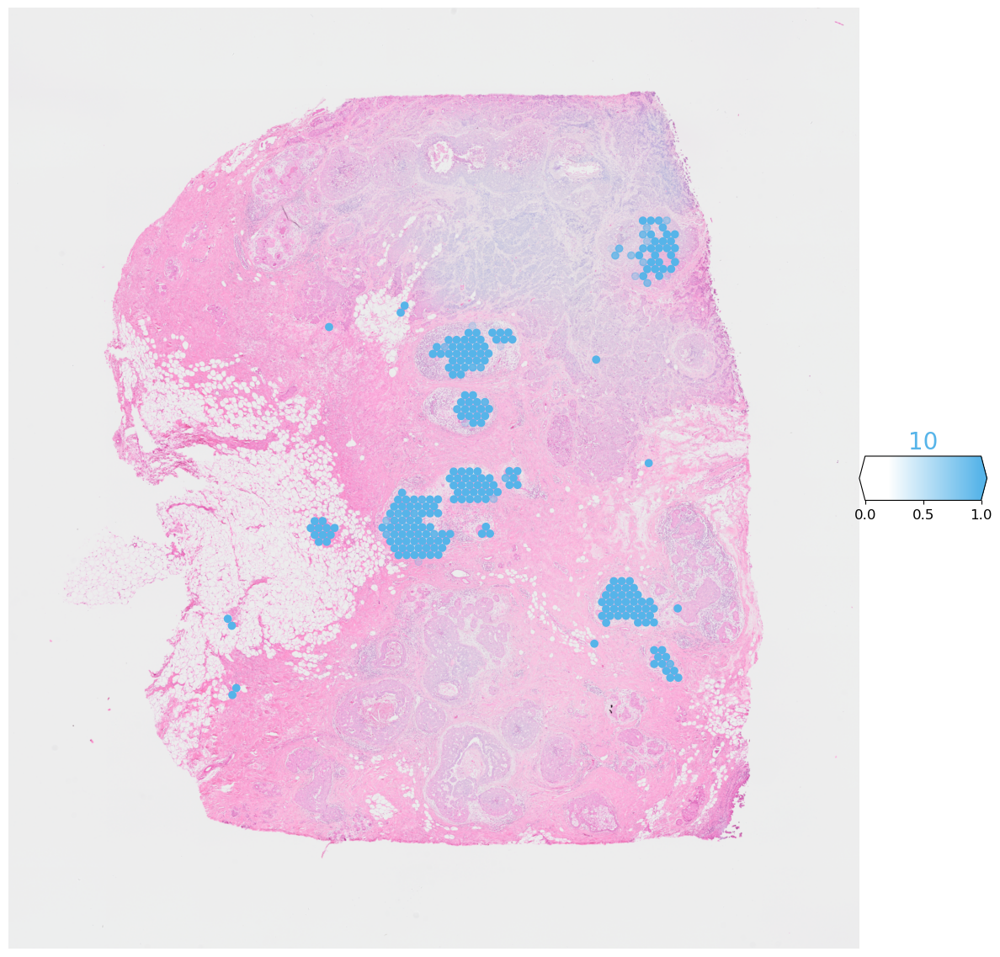

In [173]:
    with mpl.rc_context({'figure.figsize': (15, 15)}):
        fig = plot_spatial(
            adata=adata,
            # labels to show on a plot
            color=['10'], labels=['10'],
            show_img=True,
            # 'fast' (white background) or 'dark_background'
            style='fast',
            # limit color scale at 99.2% quantile of cell abundance
            max_color_quantile=0.992,
            # size of locations (adjust depending on figure size)
            circle_diameter=6,
            colorbar_position='right',reorder_cmap = [4,3,6,0,1,2,5]
        )
    fig.savefig("../reports/figures/clones_10.png", dpi = 300)

    plt.show()

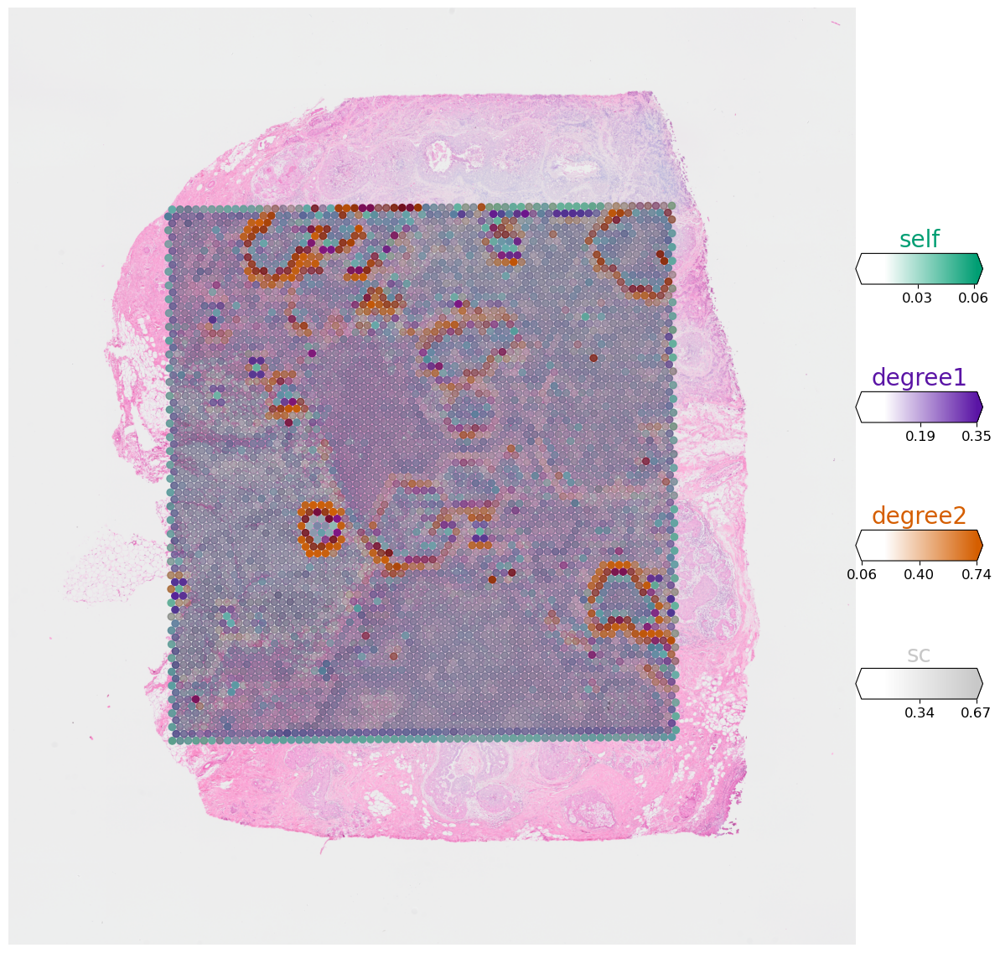

In [28]:
clust_col = ['self', 'degree1', 'degree2','sc']
with mpl.rc_context({'figure.figsize': (15, 15)}):
    fig = plot_spatial(
        adata=adata,
        # labels to show on a plot
        color=clust_col, labels=clust_col,
        show_img=True,
        # 'fast' (white background) or 'dark_background'
        style='fast',
        # limit color scale at 99.2% quantile of cell abundance
        max_color_quantile=0.992,
                    # size of locations (adjust depending on figure size)
        circle_diameter=6,
        colorbar_position='right',
        reorder_cmap = [1,2,3,5,5,6,0]
    )

In [30]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(visium, cmap='magma',
                  # show first 8 cell types
                  color=new_cols,
                  ncols=3, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2',
                 )

,in_tissue,array_row,array_col,0,1,2,3,4,5,6,...,Plasmablasts,B.cells,clone,cell_type,degree1,degree2,sc,self,umap1,umap2
AACACCTACTATCGAA-1,1,0,122,1.487234e-06,0.001420,0.092935,1.020402e-05,0.028217,1.325089e-02,0.201880,...,0.085287,0.113404,diploid,PVL,0.166225,0.333814,0.448599,0.051362,8.970247,9.451398
AACACGTGCATCGCAC-1,1,76,22,8.030731e-06,0.001211,0.048008,1.005585e-04,0.027170,2.534571e-01,0.147754,...,0.080372,0.197795,diploid,Normal Epithelial,0.233137,0.227151,0.488167,0.051546,8.041659,-0.932483
AACACTTGGCAAGGAA-1,1,47,71,2.210930e-04,0.027470,0.005615,8.056379e-05,0.127870,2.834538e-02,0.149216,...,0.000188,0.272336,diploid,B.cells,0.193249,0.298852,0.465906,0.041992,14.628860,8.613498
AACAGGAAGAGCATAG-1,1,69,7,5.259013e-06,0.000784,0.008821,8.319690e-04,0.021226,7.480152e-03,0.026923,...,0.033135,0.245864,diploid,B.cells,0.185301,0.359120,0.415630,0.039949,3.703570,10.941270
AACAGGATTCATAGTT-1,1,49,43,1.172342e-05,0.002483,0.002379,1.028128e-03,0.015314,2.611118e-04,0.015109,...,0.016003,0.212945,diploid,B.cells,0.162170,0.411332,0.389557,0.036941,2.330463,7.584463
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGTTGGAACGAGGTCA-1,1,28,72,7.764131e-06,0.001552,0.051054,2.528532e-04,0.035396,2.085912e-02,0.084078,...,0.130271,0.137678,diploid,CAFs,0.196375,0.311335,0.447940,0.044349,12.648952,12.998025
TGTTGGAAGCTCGGTA-1,1,1,95,2.089435e-06,0.000746,0.000020,3.660808e-07,0.000270,2.188444e-07,0.000666,...,0.017375,0.068673,7,Normal Epithelial,0.243928,0.312292,0.403594,0.040185,-1.470813,11.698642
TGTTGGATGGACTTCT-1,1,13,53,6.487533e-06,0.011904,0.000018,1.436942e-06,0.000277,6.138924e-08,0.001630,...,0.009022,0.067805,15,Cancer Epithelial,0.126390,0.392928,0.438391,0.042290,3.728965,7.996950
TGTTGGCCAGACCTAC-1,1,49,47,4.541216e-04,0.020873,0.008684,9.269945e-04,0.091570,9.645999e-03,0.060538,...,0.001192,0.261426,diploid,Normal Epithelial,0.132144,0.657734,0.191832,0.018290,-3.524964,-2.050928


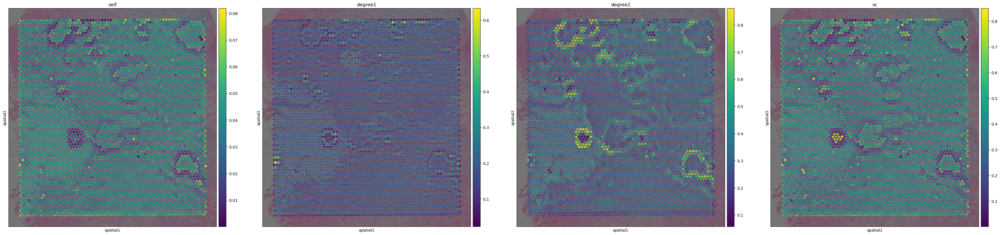

In [33]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata,
                  # show first 8 cell types
                  color=clust_col,
                img_key='lowres', alpha_img = 0.5,
                 )

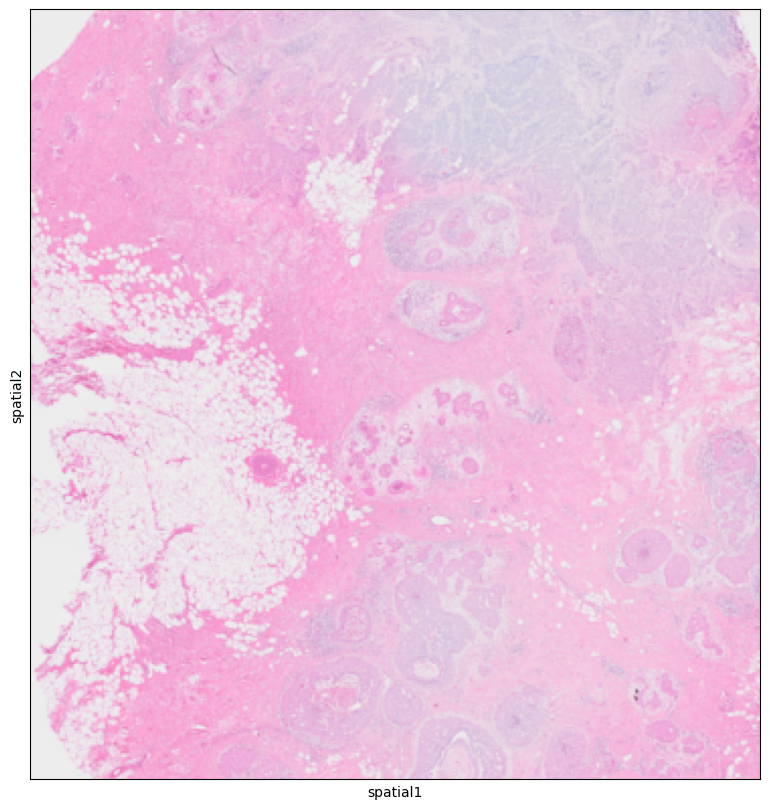

In [12]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata,

                img_key='lowres', 
                 )

In [13]:
clone_mat = adata.obs[clone_col]

In [35]:
from sklearn.metrics.pairwise import cosine_similarity

In [39]:
d = cosine_similarity(clone_mat.T)

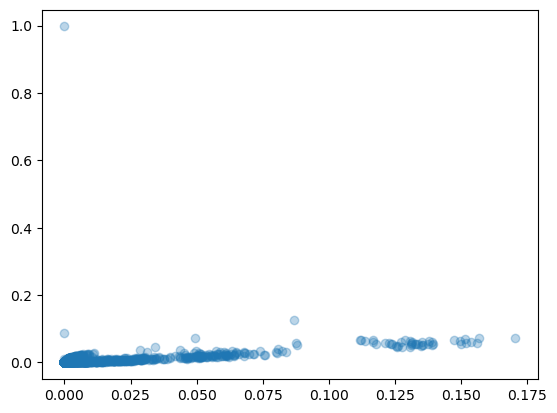

In [46]:
plt.scatter(clone_mat['15'],clone_mat['9'], alpha =0.3)
# plt.xlim(0,0.2)
# plt.ylim(0,0.2)

In [34]:
np.correlate(clone_mat['6'],clone_mat['9'])

array([0.22534862], dtype=float32)

In [14]:
# d = clone_mat.corr()

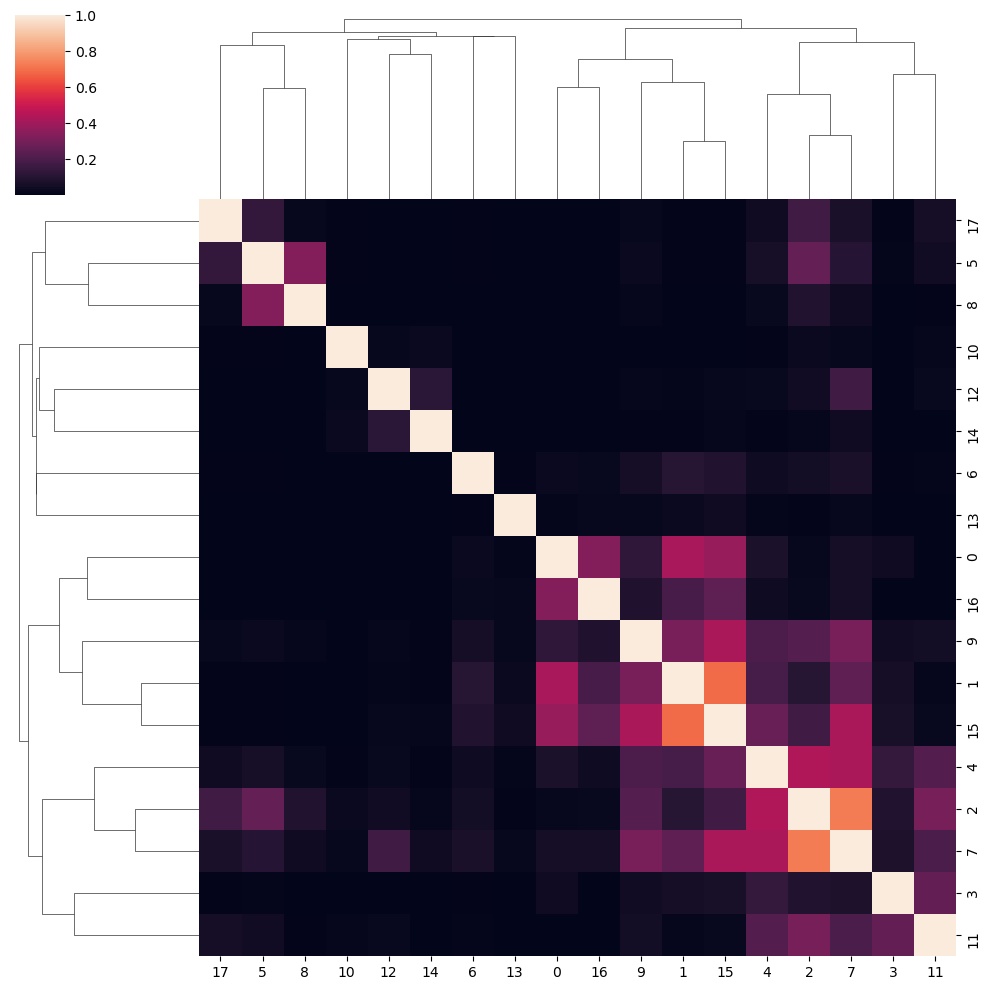

In [40]:
sns.clustermap(d)

In [11]:
pd.DataFrame(n_enr)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,94.804859,5.129273,-11.453143,3.822924,-24.654021,5.522203,0.235606,-16.536052,2.592364,-15.782353,-16.597486,-5.737783,7.540300,-5.374874,19.457525,-44.212964
1,5.129273,NaN,-1.110674,-0.063372,-0.982749,8.103497,-0.031639,-0.614223,-0.044766,-0.556489,-0.637993,-0.344891,-0.255015,-0.224733,-0.163383,-1.650957
2,-11.453143,-1.110674,73.221620,2.170564,-24.159605,-1.949296,-1.209723,-20.263650,-0.116318,-11.012709,15.860346,2.221075,-6.763881,-5.094359,-2.621902,-47.868704
3,3.822924,-0.063372,2.170564,-0.044766,-1.586606,4.836602,-0.054855,-1.052651,-0.044766,-0.999561,-1.059788,-0.556557,-0.436127,-0.399137,2.984102,-2.438882
4,-24.654021,-0.982749,-24.159605,-1.586606,74.261250,-3.340822,-0.918505,16.107531,-0.932020,-15.332902,-8.141021,-8.486342,-6.685990,-5.812836,-4.519628,-25.918464
5,5.522203,8.103497,-1.949296,4.836602,-3.340822,15.999406,-0.139169,-2.200188,7.842194,-2.084653,-1.794423,-1.128790,14.423322,-0.742685,4.525044,-3.423110
6,0.235606,-0.031639,-1.209723,-0.054855,-0.918505,-0.139169,NaN,-0.599558,-0.031639,-0.580584,-0.609610,8.810121,8.277289,-0.196014,-0.181818,-1.601584
7,-16.536052,-0.614223,-20.263650,-1.052651,16.107531,-2.200188,-0.599558,85.615553,-0.574720,-10.391630,-11.298016,-5.843827,-4.396577,-3.609145,-2.891662,-28.911155
8,2.592364,-0.044766,-0.116318,-0.044766,-0.932020,7.842194,-0.031639,-0.574720,NaN,-0.582686,-0.600613,-0.335770,-0.238919,-0.178862,-0.163383,-0.838689
9,-15.782353,-0.556489,-11.012709,-0.999561,-15.332902,-2.084653,-0.580584,-10.391630,-0.582686,81.150114,4.711571,-0.430361,-4.094891,11.007373,-2.823541,-20.843051


In [8]:
sns.set(font_scale=3)

type: The condensed distance matrix must contain only finite values.

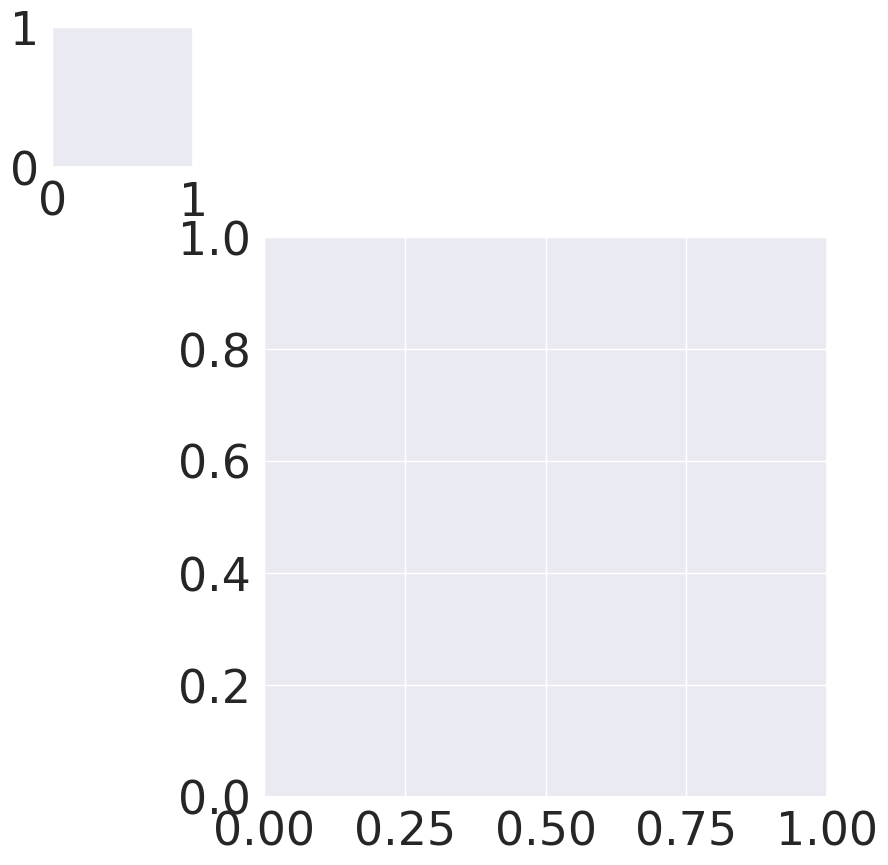

In [9]:
g = sns.clustermap(n_enr)
ax = g.ax_heatmap
ax.set_xlabel("clones")
ax.set_ylabel("clones")

# Spatial neigborhood

In [81]:
sq.gr.spatial_neighbors(adata)


  0%|          | 0/1000 [00:00<?, ?/s]

/home/o313a/.local/lib/python3.8/site-packages/squidpy/gr/_nhood.py:182: RuntimeWarning: invalid value encountered in true_divide
  zscore = (count - perms.mean(axis=0)) / perms.std(axis=0)


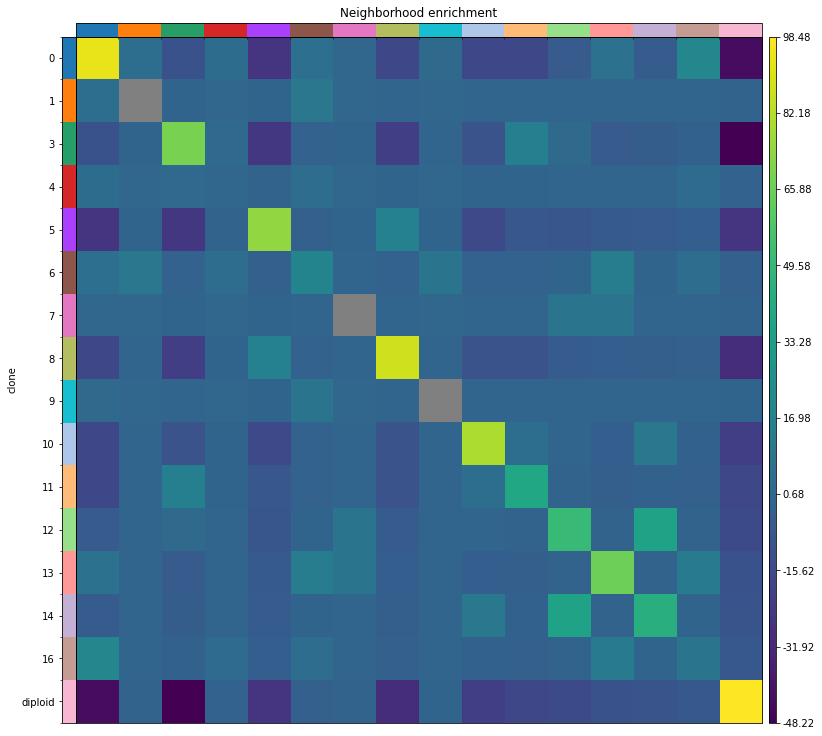

In [82]:
sq.gr.nhood_enrichment(adata, cluster_key="clone")
sq.pl.nhood_enrichment(adata, cluster_key="clone")

In [114]:
enr = adata.uns["clone_nhood_enrichment"]["zscore"]

In [115]:
clone_col_present = ['0',
 '1',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '16',
 'diploid']

In [116]:
len(clone_col_present)

16

In [117]:
enr = pd.DataFrame(enr, index =clone_col_present, columns = clone_col_present )

In [118]:
enr

,0,1,3,4,5,6,7,8,9,10,11,12,13,14,16,diploid
0,98.483491,4.915112,-11.015083,3.914278,-25.452006,5.550477,0.301691,-16.350877,2.607847,-16.202632,-16.254777,-5.866159,7.357734,-5.450551,19.593412,-43.363960
1,4.915112,98.483491,-1.133854,-0.031639,-0.922007,9.949874,-0.044766,-0.592959,-0.044766,-0.588339,-0.625571,-0.324409,-0.259430,-0.190445,-0.135388,-1.789848
3,-11.015083,-1.133854,98.483491,2.072139,-24.478178,-2.044211,-1.216414,-20.858519,-0.145036,-10.607788,15.323335,2.271642,-6.285654,-5.126235,-2.613591,-48.215880
4,3.914278,-0.031639,2.072139,98.483491,-1.678741,4.185513,-0.063372,-1.053654,-0.077693,-1.002491,-1.126031,-0.573779,-0.427422,-0.345778,3.181887,-2.264608
5,-25.452006,-0.922007,-24.478178,-1.678741,98.483491,-3.435587,-0.973793,16.281685,-0.961154,-16.028503,-8.482858,-9.070847,-6.866649,-5.806441,-4.536392,-25.837040
6,5.550477,9.949874,-2.044211,4.185513,-3.435587,98.483491,-0.100504,-2.199046,8.392173,-2.007634,-1.843416,-1.120156,14.021773,-0.747218,4.401975,-3.201345
7,0.301691,-0.044766,-1.216414,-0.063372,-0.973793,-0.100504,98.483491,-0.602549,-0.031639,-0.570336,-0.637157,8.146818,7.956054,-0.204124,-0.175863,-1.670484
8,-16.350877,-0.592959,-20.858519,-1.053654,16.281685,-2.199046,-0.602549,98.483491,-0.604450,-10.412770,-10.923943,-5.692568,-4.491651,-3.538312,-3.054975,-29.063436
9,2.607847,-0.044766,-0.145036,-0.077693,-0.961154,8.392173,-0.031639,-0.604450,98.483491,-0.574457,-0.634261,-0.333405,-0.266293,-0.209383,-0.175863,-0.738012
10,-16.202632,-0.588339,-10.607788,-1.002491,-16.028503,-2.007634,-0.570336,-10.412770,-0.574457,98.483491,4.659575,-0.462867,-4.151147,10.769576,-2.835034,-20.742683


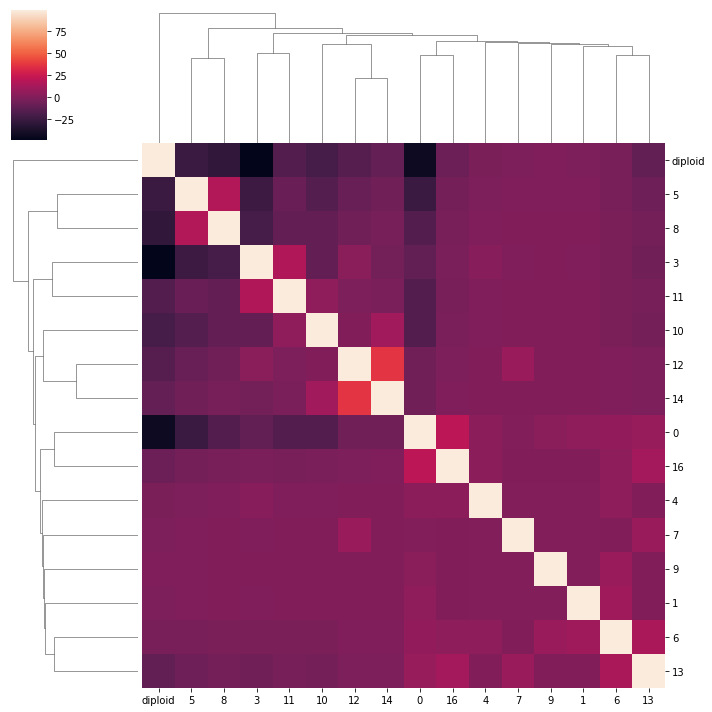

In [119]:
sns.clustermap(enr)

In [120]:
pdist = distance.pdist(enr)
link = linkage(pdist, method='complete')


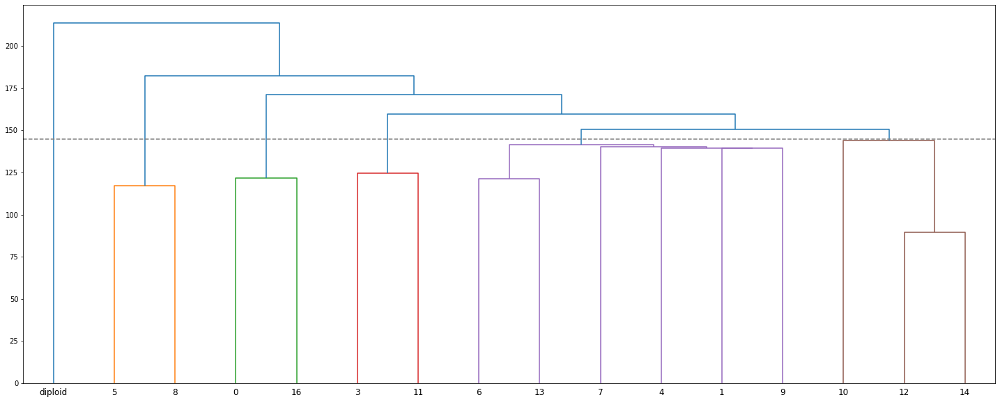

In [122]:
t = 145
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(link,color_threshold = t, labels = enr.columns)
plt.axhline(t, ls = "--", color = "grey" )

In [123]:
clusters = fcluster(link, t, criterion='distance')

In [124]:
clusters

array([2, 4, 3, 4, 1, 4, 4, 1, 4, 5, 3, 5, 4, 5, 2, 6], dtype=int32)

In [125]:
new_clones = []
new_cols = []
un_clusters = np.unique(clusters)
for cl in un_clusters:
    idx = np.where(clusters == cl)[0]
    old_clones =  enr.columns[idx]
    act = clone_mat[old_clones].sum(axis = 1)
    new_clones.append(act.values)
    new_cols.append(" & ".join([str(x) for x in old_clones]))




    

In [126]:
new_clones = pd.DataFrame(new_clones, index = new_cols, columns = clone_mat.index).T

In [127]:
visium = adata.copy()

In [128]:
visium.obs = visium.obs.drop(columns = clone_col + ["clone"])

In [129]:
visium.obs = visium.obs.join(new_clones)

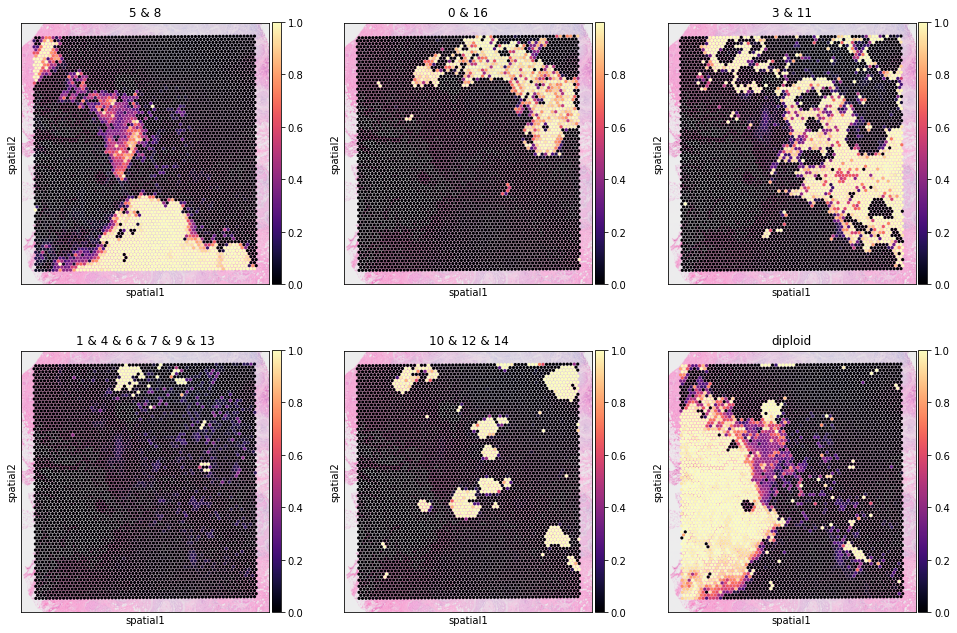

In [130]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(visium, cmap='magma',
                  # show first 8 cell types
                  color=new_cols,
                  ncols=3, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax='p99.2',
                 )

In [18]:





def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


In [6]:
model = AgglomerativeClustering(metric = "correlation", distance_threshold=0, n_clusters=None, linkage = "complete").fit(clone_mat)


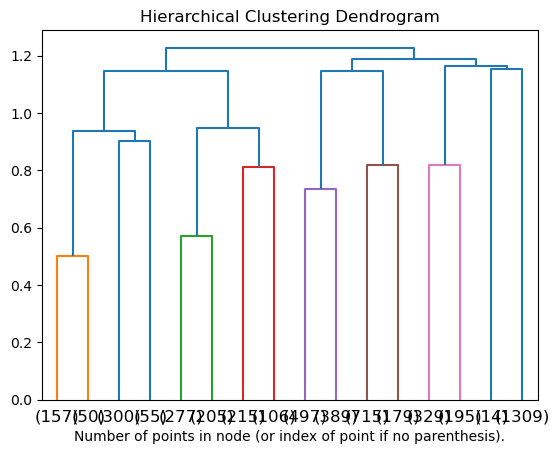

In [7]:
model = model.fit(clone_mat)
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [8]:
clustering = AgglomerativeClustering(metric = "correlation", n_clusters = 10, linkage = "complete").fit(clone_mat)


In [9]:
adata.obs["niches_clone"] =[str (x) for x in clustering.labels_]

In [10]:
import matplotlib as mpl


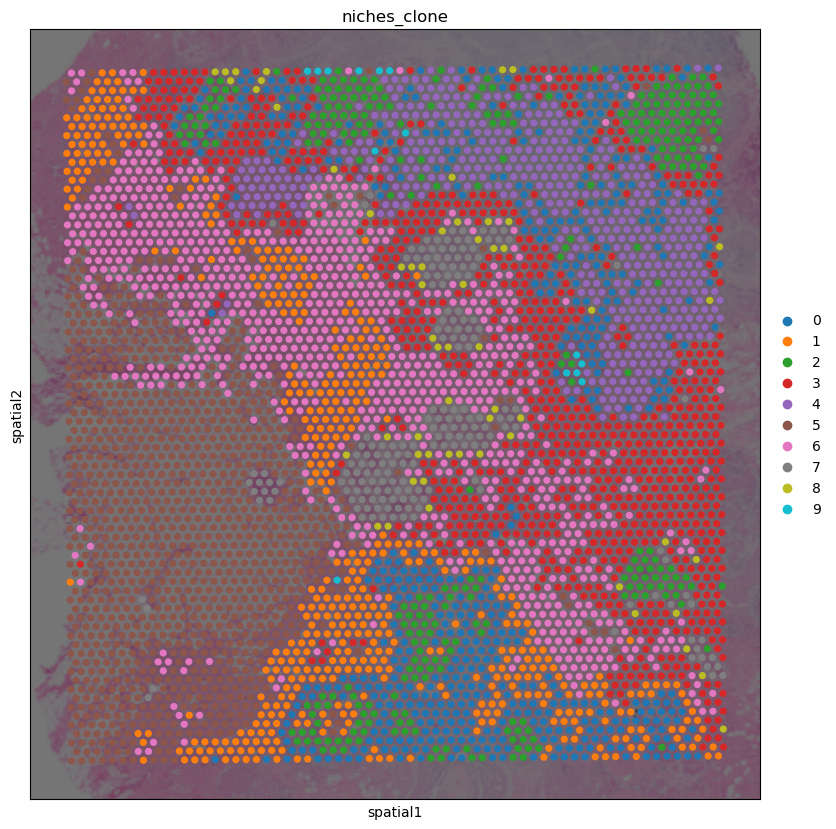

In [11]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata,
                  # show first 8 cell types
                  color="niches_clone",
                img_key='lowres', alpha_img = 0.5,
                 )

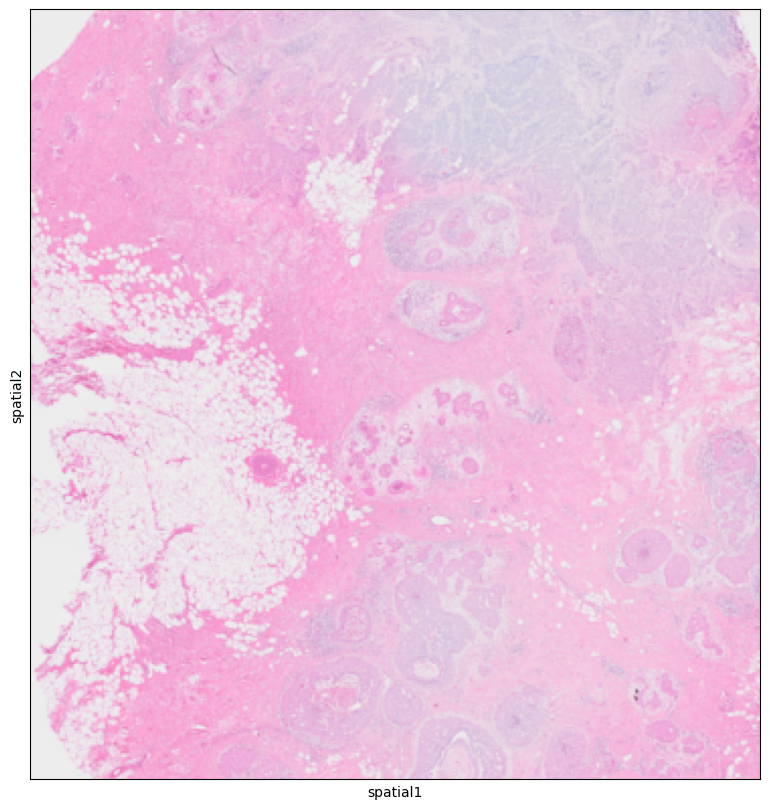

In [12]:
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [10, 10]}):
    sc.pl.spatial(adata,

                img_key='lowres', 
                 )

In [13]:
clone_mat = adata.obs[clone_col]

In [35]:
from sklearn.metrics.pairwise import cosine_similarity

In [39]:
d = cosine_similarity(clone_mat.T)

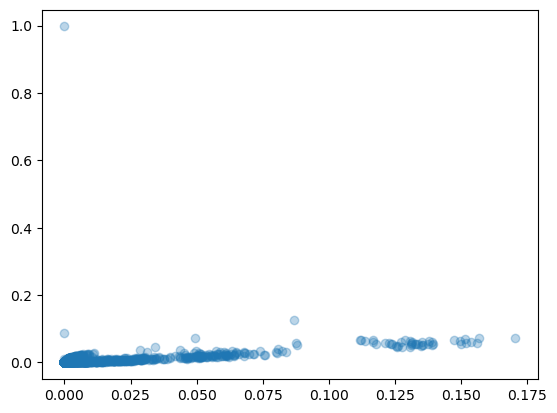

In [46]:
plt.scatter(clone_mat['15'],clone_mat['9'], alpha =0.3)
# plt.xlim(0,0.2)
# plt.ylim(0,0.2)

In [34]:
np.correlate(clone_mat['6'],clone_mat['9'])

array([0.22534862], dtype=float32)

In [14]:
# d = clone_mat.corr()

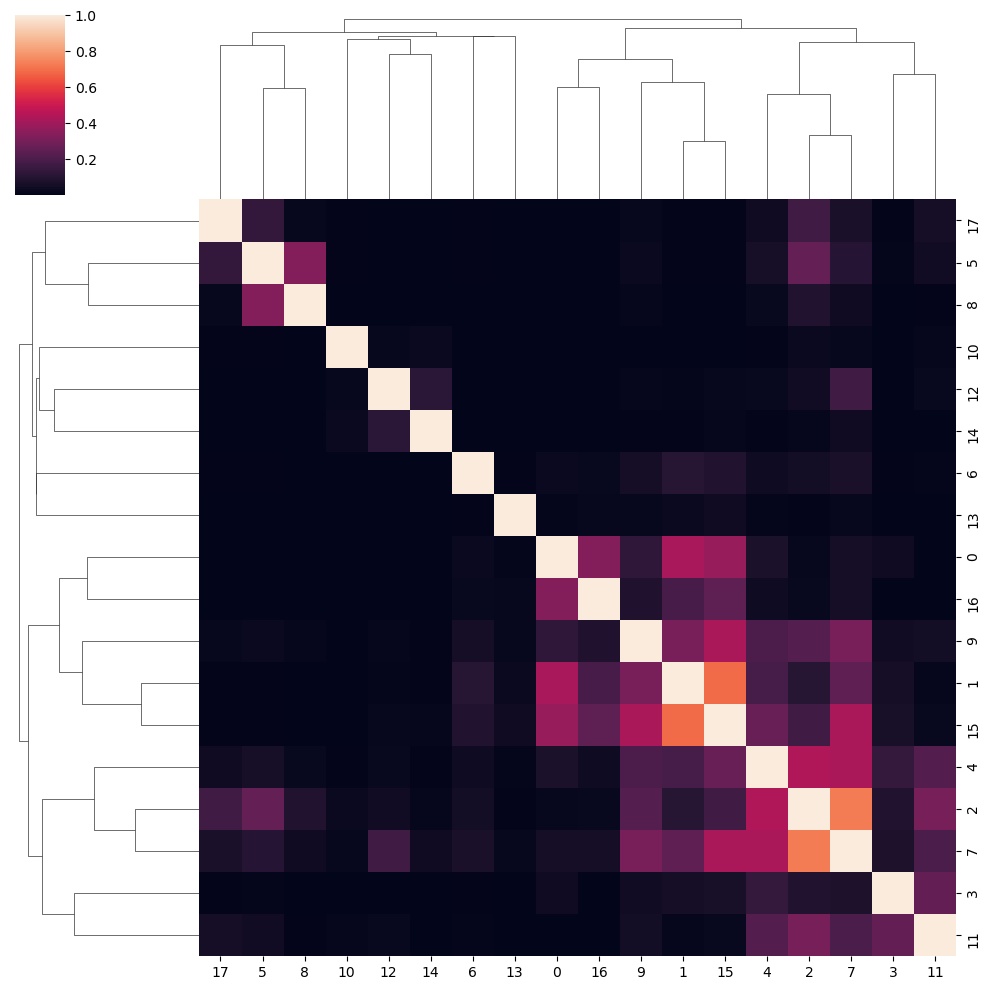

In [40]:
sns.clustermap(d)

In [11]:
pd.DataFrame(n_enr)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,94.804859,5.129273,-11.453143,3.822924,-24.654021,5.522203,0.235606,-16.536052,2.592364,-15.782353,-16.597486,-5.737783,7.540300,-5.374874,19.457525,-44.212964
1,5.129273,NaN,-1.110674,-0.063372,-0.982749,8.103497,-0.031639,-0.614223,-0.044766,-0.556489,-0.637993,-0.344891,-0.255015,-0.224733,-0.163383,-1.650957
2,-11.453143,-1.110674,73.221620,2.170564,-24.159605,-1.949296,-1.209723,-20.263650,-0.116318,-11.012709,15.860346,2.221075,-6.763881,-5.094359,-2.621902,-47.868704
3,3.822924,-0.063372,2.170564,-0.044766,-1.586606,4.836602,-0.054855,-1.052651,-0.044766,-0.999561,-1.059788,-0.556557,-0.436127,-0.399137,2.984102,-2.438882
4,-24.654021,-0.982749,-24.159605,-1.586606,74.261250,-3.340822,-0.918505,16.107531,-0.932020,-15.332902,-8.141021,-8.486342,-6.685990,-5.812836,-4.519628,-25.918464
5,5.522203,8.103497,-1.949296,4.836602,-3.340822,15.999406,-0.139169,-2.200188,7.842194,-2.084653,-1.794423,-1.128790,14.423322,-0.742685,4.525044,-3.423110
6,0.235606,-0.031639,-1.209723,-0.054855,-0.918505,-0.139169,NaN,-0.599558,-0.031639,-0.580584,-0.609610,8.810121,8.277289,-0.196014,-0.181818,-1.601584
7,-16.536052,-0.614223,-20.263650,-1.052651,16.107531,-2.200188,-0.599558,85.615553,-0.574720,-10.391630,-11.298016,-5.843827,-4.396577,-3.609145,-2.891662,-28.911155
8,2.592364,-0.044766,-0.116318,-0.044766,-0.932020,7.842194,-0.031639,-0.574720,NaN,-0.582686,-0.600613,-0.335770,-0.238919,-0.178862,-0.163383,-0.838689
9,-15.782353,-0.556489,-11.012709,-0.999561,-15.332902,-2.084653,-0.580584,-10.391630,-0.582686,81.150114,4.711571,-0.430361,-4.094891,11.007373,-2.823541,-20.843051


In [8]:
sns.set(font_scale=3)

type: The condensed distance matrix must contain only finite values.

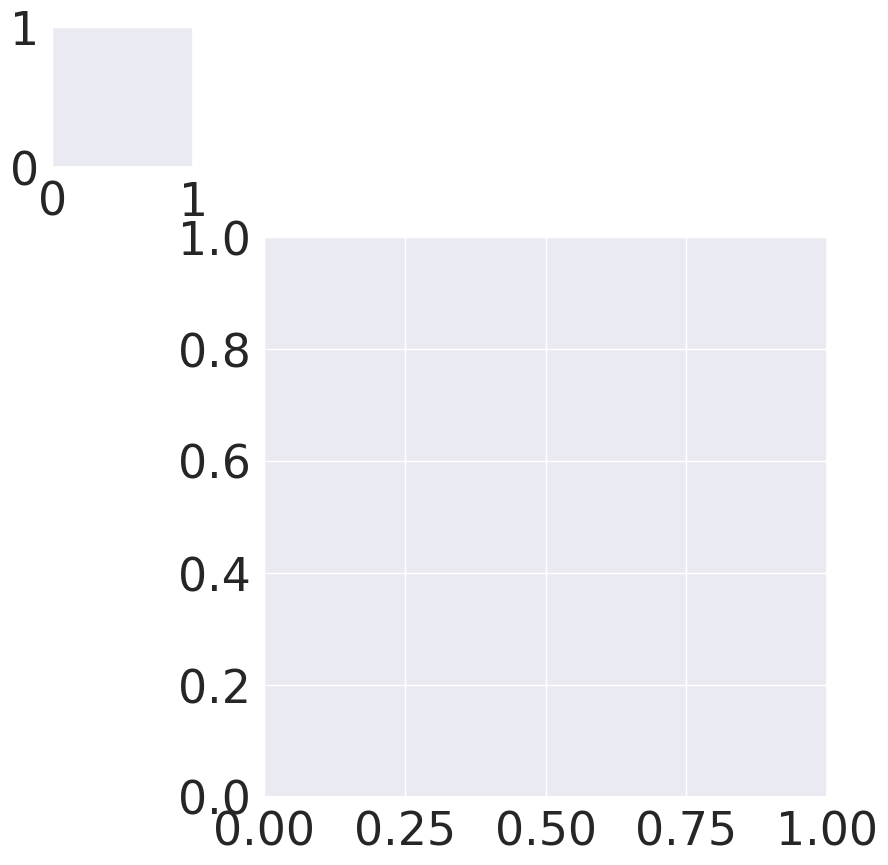

In [9]:
g = sns.clustermap(n_enr)
ax = g.ax_heatmap
ax.set_xlabel("clones")
ax.set_ylabel("clones")